<a href="https://colab.research.google.com/github/virbickt/default-risk-prediction/blob/main/exploratory_data_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# @title Dependencies

!pip install featuretools | grep -v 'Requirement already satisfied'
!pip install feature_engine | grep -v 'Requirement already satisfied'
!pip install bayesian-optimization | grep -v 'Requirement already satisfied'
!pip install facets-overview | grep -v 'Requirement already satisfied'
!pip install pycaret | grep -v 'Requirement already satisfied'
!pip install tune-sklearn ray[tune] | grep -v 'Requirement already satisfied'
!pip install boruta | grep -v 'Requirement already satisfied'
!pip install yellowbrick | grep -v 'Requirement already satisfied'

In [ ]:
# @title Imports

import base64
import warnings
from collections import Counter

import numpy as np
import pandas as pd
import seaborn as sns
from IPython.core.display import HTML, display
from matplotlib import pyplot as plt
from sklearn.base import BaseEstimator, TransformerMixin, clone
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestClassifier
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, roc_auc_score
from sklearn.model_selection import (
    GridSearchCV,
    KFold,
    StratifiedKFold,
    cross_val_score,
    train_test_split,
)
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import (
    MinMaxScaler,
    OneHotEncoder,
    QuantileTransformer,
    RobustScaler,
    StandardScaler,
)

import featuretools as ft
import lightgbm as lgb
import missingno as msno
from bayes_opt import BayesianOptimization
from boruta import BorutaPy
from facets_overview.generic_feature_statistics_generator import GenericFeatureStatisticsGenerator
from feature_engine.encoding import (
    CountFrequencyEncoder,
    DecisionTreeEncoder,
    MeanEncoder,
    OrdinalEncoder,
    PRatioEncoder,
    WoEEncoder,
)
from feature_engine.imputation import (
    AddMissingIndicator,
    ArbitraryNumberImputer,
    CategoricalImputer,
    EndTailImputer,
    MeanMedianImputer,
    RandomSampleImputer,
)
from imblearn.over_sampling import SMOTE, BorderlineSMOTE
from lightgbm import LGBMClassifier, plot_importance
from plotly import express as px, graph_objects as go
from pycaret import classification as pycr, utils as pycu
from pycaret.classification import *
from yellowbrick.target import FeatureCorrelation


warnings.filterwarnings("ignore")


In [ ]:
# @title Globals

RANDOM_STATE = 13

test_df = pd.read_csv("/content/drive/MyDrive/341/application_test.csv")
TEST_IDS = test_df.SK_ID_CURR
columns = app_train.select_dtypes("object").columns

In [ ]:
# @title Uploads

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Exploratory Data Analysis

We will replace the somewhat standard `.describe()`-step within the exploratory data analysis part with a facets overview:

>*Facets-Overview gives a high-level view of one or more data sets by producing  a visual feature-by-feature statistical analysis.* 
(https://pair-code.github.io/facets/)  

In addition to descriptive statistics that are provided by pandas `.describe()` we are also provided with means for visual feature analysis. We also get the aspects of the data that are of potential interest (such as a high proportion of missing data, or very different distributions of a feature across multiple datasets) that are highlighted in red. 

In order to access the overview, please open the notebook on Google Colab/Jupyter Notebooks.

In [ ]:
# @title Facets-overview
# Create the feature stats for the datasets and stringify it (prerequisite steps in order to produce a facets web-component and embed it in the notebook)

gfsg = GenericFeatureStatisticsGenerator()
proto = gfsg.ProtoFromDataFrames(
    [{"name": "train", "table": app_train}, {"name": "test", "table": app_test}]
)
protostr = base64.b64encode(proto.SerializeToString()).decode("utf-8")

HTML_TEMPLATE = """
        <script src="https://cdnjs.cloudflare.com/ajax/libs/webcomponentsjs/1.3.3/webcomponents-lite.js"></script>
        <link rel="import" href="https://raw.githubusercontent.com/PAIR-code/facets/1.0.0/facets-dist/facets-jupyter.html" >
        <facets-overview id="elem"></facets-overview>
        <script>
          document.querySelector("#elem").protoInput = "{protostr}";
        </script>"""
html = HTML_TEMPLATE.format(protostr=protostr)
display(HTML(html))

A things to notice:
- Facets brings to our attention the volume of missing values across the columns, something we will investigate further in the following section.
- We can see that there are categorical features which have different cardinality (different types of values) across train set and test set in `NAME_EDUCATION_TYPE`, `CODE GENDER`, `NAME_OCCUPATION_TYPE`
- We can also observe that some of the features possess very little variability (e. g. `EMERGENCYSTATE_MODE` has only a fraction of values with "Yes"). We would not expect features with little to none variability to contribute much in terms of predictiveness.
- Moreover, we can read the outlier values off the info table (something that we could have also done with `.describe()`)


# Outliers

In terms of outliers, a source of potential interest is `DAYS_BIRTH`. It is difficult to determine whether values such as -7,489 should be considered an outlier given that we are more used to using ages represented in years. For this purpose, let us plot the values of `DAYS_BIRTH` in days (in order to see the plot, please open the notebook): 

In [ ]:
fig = go.Figure()
fig.add_trace(go.Histogram(name="application_train (train set)", x=abs(app_train.DAYS_BIRTH / 365)))
fig.add_trace(go.Histogram(name="application_test (test set)", x=abs(app_test.DAYS_BIRTH / 365)))

# Overlaying histograms for train and test sets
fig.update_layout(
    barmode="overlay",
    title="DAYS_BIRTH (divided by 365 as the values are originally in days) across the train and test set",
    xaxis_title="Age Group",
    yaxis_title="Count",
    title_font_family="Raleway",
)
fig.update_xaxes(title_font_family="Raleway")

# Reducing opacity
fig.update_traces(opacity=0.75)
fig.show()

While were unable to locate any outliers in `AGE_GROUP`, it is not the case with `DAYS_EMLOYED`:

In [ ]:
fig = go.Figure()
fig.add_trace(go.Histogram(name="application_train (train set)", x=abs(app_train.DAYS_EMPLOYED / 365)))
fig.add_trace(go.Histogram(name="application_test (test set)", x=abs(app_test.DAYS_EMPLOYED / 365)))

# Overlaying histograms for train and test sets
fig.update_layout(
    barmode="overlay",
    title="DAYS_EMPLOYED (divided by 365 as the values are originally in days) across the train and test set",
    xaxis_title="Years Employed",
    yaxis_title="Count",
    title_font_family="Raleway",
)
fig.update_xaxes(title_font_family="Raleway")

# Reducing opacity
fig.update_traces(opacity=0.75)
fig.show()

According to the data, there has been $\approx$ 65k people who have been employed over a thousand year. While in the universe where people can live for a thousand years this would truly signal of dedication, it is much more likely that there has been flaws in the data collection process. We therefore replace these values accordingly: 

In [ ]:
app_train[app_train["DAYS_EMPLOYED"]/365 > 80] = np.nan
app_test[app_test["DAYS_EMPLOYED"]/365 > 80] = np.nan

Moreover, there are values such that they appear in the train set but not in the test set:

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=3)

fig.add_trace(
    go.Histogram(name="CODE_GENDER (Gender of a client)", x=app_train.CODE_GENDER, histnorm=''),
    row=1, col=1
)

fig.add_trace(
    go.Histogram(name="NAME_FAMILY_STATUS (Family status of a client)", x=app_train.NAME_FAMILY_STATUS, histnorm=''),
    row=1, col=2
)

fig.add_trace(
    go.Histogram(name="NAME_INCOME_TYPE (Income type of a client)", x=app_train.NAME_INCOME_TYPE, histnorm=''),
    row=1, col=3
)

fig.update_layout(title_text="Distribution of different types of values across CODE_GENDER, NAME_FAMILY_STATUS and NAME_INCOME_TYPE",
    title_font_family="Raleway", legend=dict(
    yanchor="top",
    y=-0.10,
    xanchor="left",
    x=0.00
))
fig.update_xaxes(title_font_family="Raleway")
fig.show()

# Missing values

Exploratory data analysis inevitable leads us to the issue of missing values.  Let us first identify the number of features with values missing across the tables:

In [ ]:
datasets = [
    app_train,
    app_train,
    bureau,
    bureau_balance,
    cash,
    credit,
    previous,
    installments,
]
dataset_names = [
    "app_df",
    "app_train",
    "bureau",
    "bureau_balance",
    "cash",
    "credit",
    "previous",
    "installments",
]

for df, df_name in zip(datasets, dataset_names):
    print(
        f"Number of columns with missing values in {df_name}:",
        df.isna().any().sum(),
        f"of {df.shape[1]}",
    )

Number of columns with missing values in app_df: 69 of 122
Number of columns with missing values in app_train: 69 of 122
Number of columns with missing values in bureau: 7 of 17
Number of columns with missing values in bureau_balance: 0 of 4
Number of columns with missing values in cash: 2 of 9
Number of columns with missing values in credit: 9 of 24
Number of columns with missing values in previous: 16 of 37
Number of columns with missing values in installments: 2 of 9


While we've seen hints of the volume of values missing in `application_train`, we can now see that there's a little more than half of the features across the train and test sets. In what follows we will look into the percentages of missing values across the features in train and test sets. 

In [ ]:
missing_train = missing_values_pct(app_train)
missing_test = missing_values_pct(app_test)

display_side_by_side([missing_test, missing_train], ["caption1", "caption2"])

Let us see whether there are features among those in test set that have more values missing than those in the train set.

In [ ]:
for col1, col2 in zip(app_train.columns, app_test.columns):
  if app_train[col1].isna().sum() < app_test[col2].isna().sum():
    print(f"There are more missing values for {col2} in test set than in {col1} in train set")
    print(f'The difference is {app_test[col2].isna().sum() - app_train[col1].isna().sum()} values')

Since there's only one feature that has more values missing, it seems safe to proceed with further investigation of missing values by taking the train set as a representative.

## Missing values (train set)

Let us use `missingno` to see the counts of missing values across the features visually

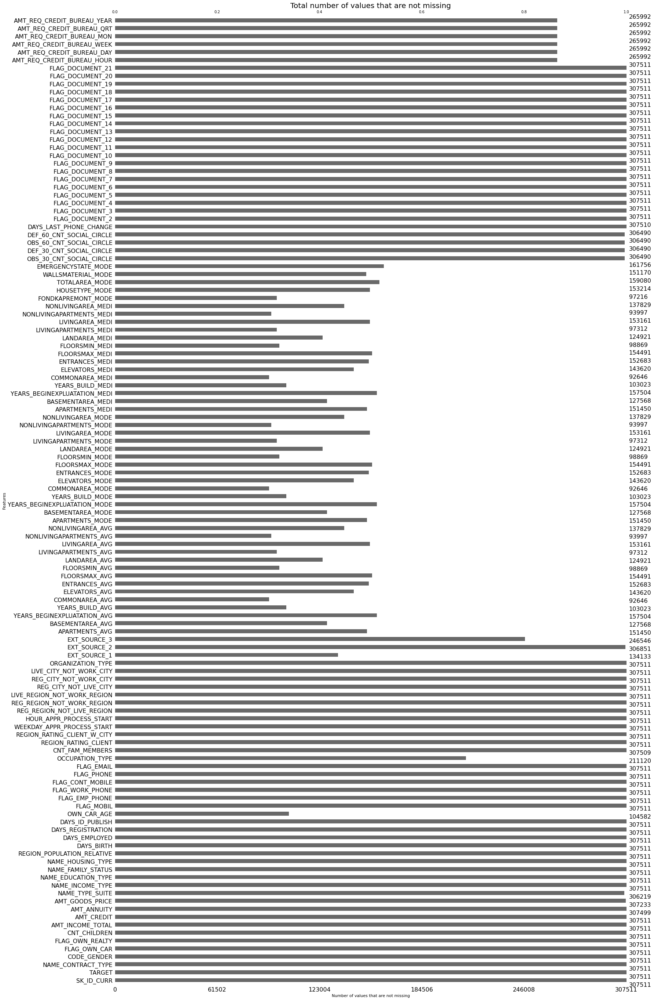

In [ ]:
plt.title("Total number of values that are not missing", fontsize=20)
plt.ylabel("Features", fontsize=11)
plt.xlabel("Number of values that are not missing", fontsize=11)
msno.bar(app_train)

## Flagging missing values

In what follows we will be making changes to the data, so before we proceed, let us first add a feature that tracks the number of missing feature for each applicant. `FLAG_INCOMPLETE` will represent whether there were 35 or more values missing across the total of 122 features that represent a single applicant whereas `MISSING_COUNT_INFO` tracks the precise number of values missing per applicant. 

In [ ]:
for df in [app_train, app_test]:
  df['FLAG_INCOMPLETE'] = 1
  df.loc[df.isnull().sum(axis=1) < 35, 'FLAG_INCOMPLETE'] = 0
  df['MISSING_INFO_COUNT'] = df.isnull().sum(axis=1)

### Missing values (train set): First block

The features with missing values can be grouped into three groups that we will zoom onto sequentially. First, there's `AMT_CREDIT_BUREAU` features that tracks the number of enquirees to Credit Bureau about the client on different time intervals:

In [ ]:
amt_req_credit_bureau = [
    "AMT_REQ_CREDIT_BUREAU_YEAR",
    "AMT_REQ_CREDIT_BUREAU_QRT",
    "AMT_REQ_CREDIT_BUREAU_MON",
    "AMT_REQ_CREDIT_BUREAU_WEEK",
    "AMT_REQ_CREDIT_BUREAU_DAY",
    "AMT_REQ_CREDIT_BUREAU_HOUR",
]

missing_values_pct(app_train[amt_req_credit_bureau])

,Total,Percentage
AMT_REQ_CREDIT_BUREAU_YEAR,41519,0.135016
AMT_REQ_CREDIT_BUREAU_QRT,41519,0.135016
AMT_REQ_CREDIT_BUREAU_MON,41519,0.135016
AMT_REQ_CREDIT_BUREAU_WEEK,41519,0.135016
AMT_REQ_CREDIT_BUREAU_DAY,41519,0.135016
AMT_REQ_CREDIT_BUREAU_HOUR,41519,0.135016


From the column description we know that these variables are mutually disjoint - the weekly data does not include the daily data and so forth. Therefore, the fact that there's exactly the same amount of values missing across these features that represent the number of requests on the applicant across different times intervals suggests the there have inquires on the applicant at all: nor during the last hours, nor during the last week, *et cetera*.



In [ ]:
for df in [app_train, app_test]:
    df.loc[
        (df["AMT_REQ_CREDIT_BUREAU_HOUR"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_DAY"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_WEEK"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_MON"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_QRT"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_YEAR"].isna()),
        "AMT_REQ_CREDIT_BUREAU_HOUR",
    ] = 0

    df.loc[
        (df["AMT_REQ_CREDIT_BUREAU_HOUR"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_DAY"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_WEEK"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_MON"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_QRT"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_YEAR"].isna()),
        "AMT_REQ_CREDIT_BUREAU_DAY",
    ] = 0

    df.loc[
        (df["AMT_REQ_CREDIT_BUREAU_HOUR"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_DAY"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_WEEK"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_MON"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_QRT"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_YEAR"].isna()),
        "AMT_REQ_CREDIT_BUREAU_WEEK",
    ] = 0

    df.loc[
        (df["AMT_REQ_CREDIT_BUREAU_HOUR"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_DAY"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_WEEK"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_MON"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_QRT"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_YEAR"].isna()),
        "AMT_REQ_CREDIT_BUREAU_MON",
    ] = 0

    df.loc[
        (df["AMT_REQ_CREDIT_BUREAU_HOUR"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_DAY"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_WEEK"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_MON"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_QRT"].isna())
        & (df["AMT_REQ_CREDIT_BUREAU_YEAR"].isna()),
        "AMT_REQ_CREDIT_BUREAU_QRT",
    ] = 0

    df.loc[
        (df["AMT_REQ_CREDIT_BUREAU_HOUR"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_DAY"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_WEEK"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_MON"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_QRT"] == 0)
        & (df["AMT_REQ_CREDIT_BUREAU_YEAR"].isna()),
        "AMT_REQ_CREDIT_BUREAU_YEAR",
    ] = 0

### Missing values (train set): Second block

The features in the second block mostly have to do with housing. However, among those features that have half the values missing can still be those who have only a little percent of values missing. To see this, let us zoom in on the remaining features with values missing and plot them again.

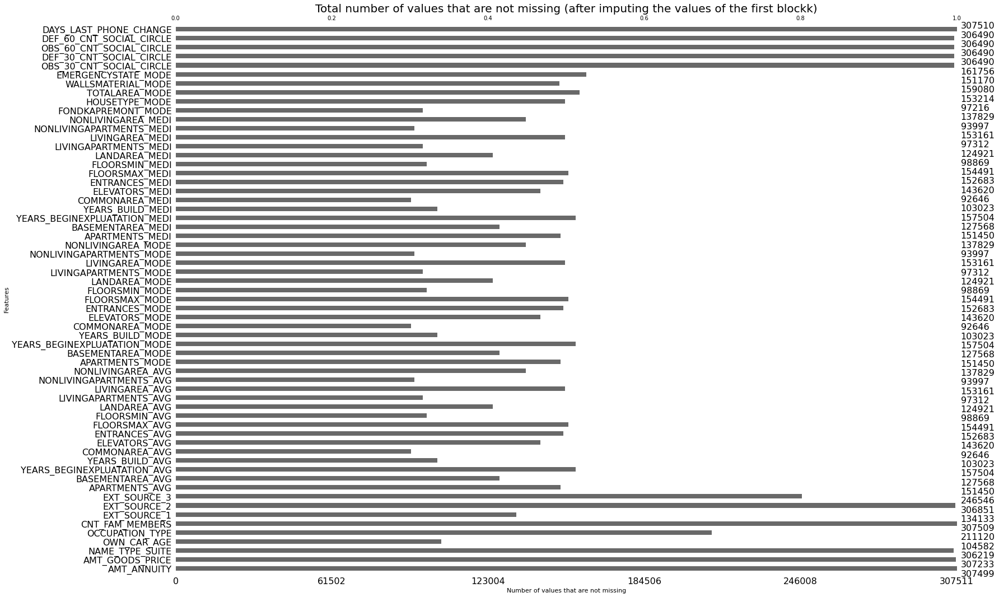

In [ ]:
feats_miss = app_train[app_train.columns[app_train.isnull().any()]]

plt.title("Total number of values that are not missing (after imputing the values of the first blockk)", fontsize=20)
plt.ylabel("Features", fontsize=11)
plt.xlabel("Number of values that are not missing", fontsize=11)

msno.bar(feats_miss)

# Target

We already know that the target variable is binary, which it can only take values `0` (for not defaulting on the loan) and `1` (for defaulting on the loan). Assuming that taking a loan comes as a well-considered decision, we would not expect for a big percent of the total applicants not to pay back their loan within a given time. While this turns out to be the case, we now know that we have a problem of *class-inbalance* on our hands.

In [ ]:
import plotly.graph_objects as go

colors = ['lightslategray',] * 5
colors[1] = 'crimson'

fig = go.Figure(data=[go.Bar(
    x=['0 (will not default)', '1 (will default)'],
    y=[app_train[app_train.TARGET == 0].shape[0], app_train[app_train.TARGET == 1].shape[0]],
    marker_color=colors # marker color can be a single color value or an iterable
)])
fig.update_layout(title_text='Counts of the values of the binary target variable',
    title_font_family="Raleway",
)

fig.show()

# Correlations

We will now proceed with a heatmap which is a standard way to visualize Pearson-coefficients between both the predictors and the target variable and between the predictors themselfs. It will allow us to:
- find the predictors with are most correlated with a target variable;
- identify the possible multicollinearity between the predictors

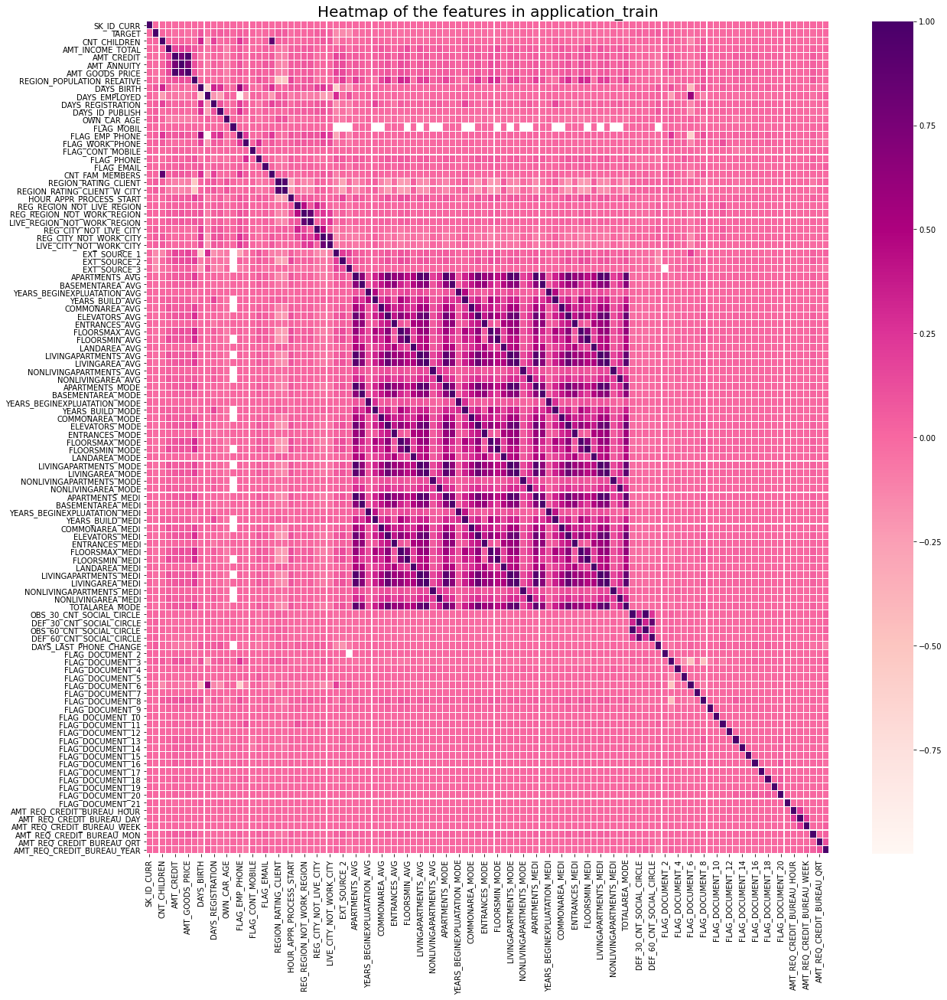

In [ ]:
# correlation map
f, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(
    app_train.corr(), annot=False, linewidth=".1", cmap="RdPu", fmt=".2f", ax=ax
)
plt.title("Heatmap of the features in application_train", fontsize=20)
plt.show()

Let us now focus specifically on the correlations with the target variable:

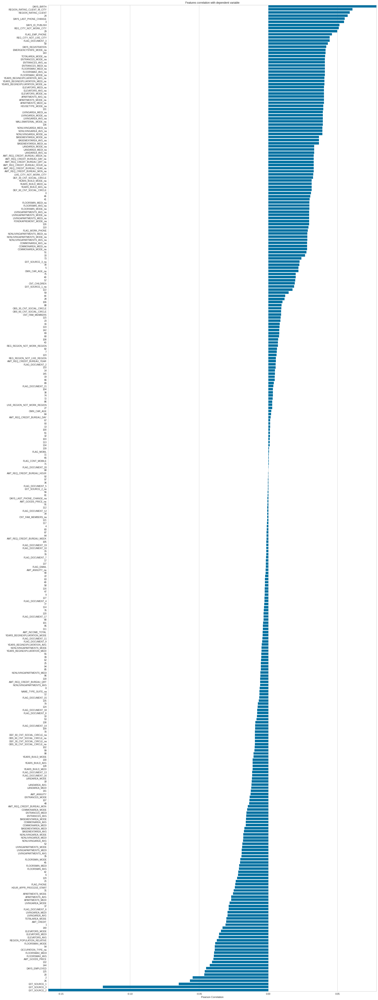

In [ ]:
#import imputed and encoded version of the same data
# WORKING_train = pd.read_csv("/content/drive/MyDrive/341/WORKING_train.csv").drop(columns=["Unnamed: 0"])

f, ax = plt.subplots(figsize=(20, 60))

# Ccreate a list of the feature names
features = np.array(WORKING_train.columns.tolist())

# fnstantiate the visualizer
visualizer = FeatureCorrelation(labels=features, sort=True)

# fit the data to the visualizer
visualizer.fit(WORKING_train, app_train.TARGET)

# Finalize and render the figure
plt.subplots_adjust(top = 1, bottom = 0, right = 1, left = 0, 
            hspace = 0, wspace = 0)
plt.margins(0,0)
visualizer.show();           

We can see that data coming from external sources (`EXT_SOURCE_2`, `EXT_SOURCE_3`, `EXT_SOURCE_1`) is most negatively (however weakly) correlated with the target variable while the age of the applicant the the rating of the region which he is located at are amongt the most positively correlated features with the target variable. 